In [ ]:
!pip install mediapipe

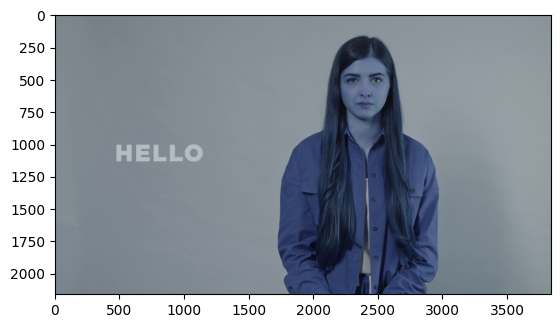

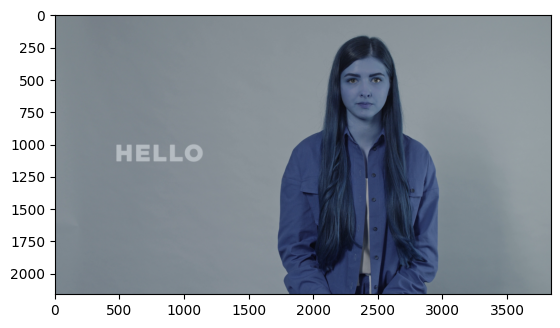

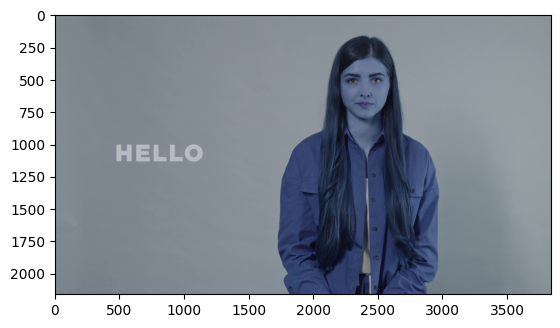

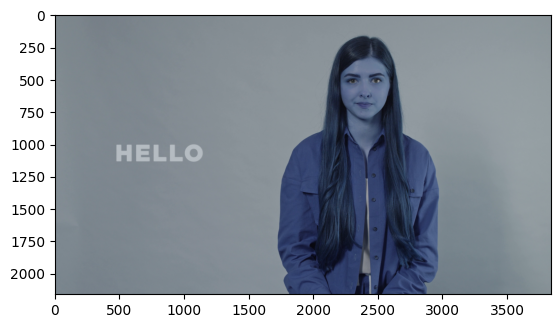

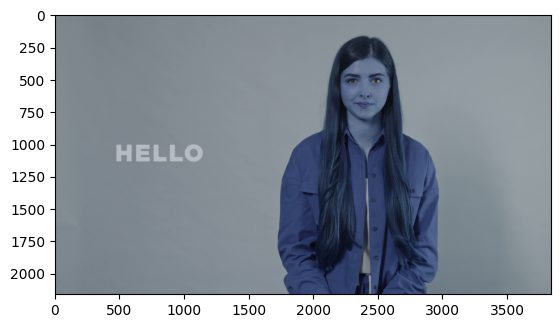

...

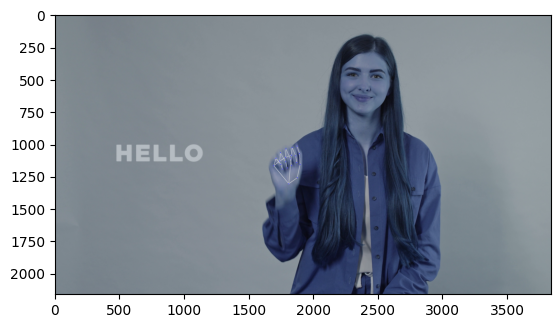

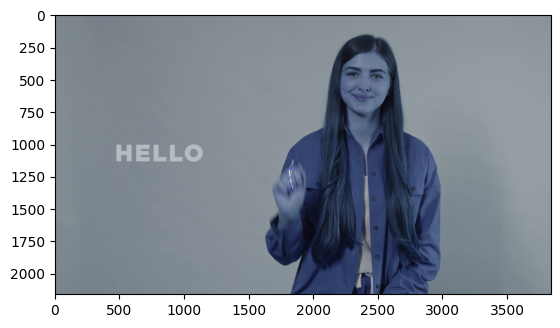

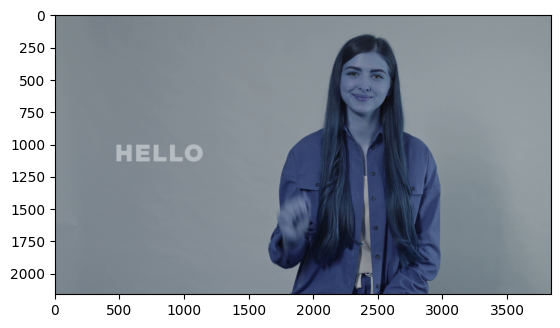

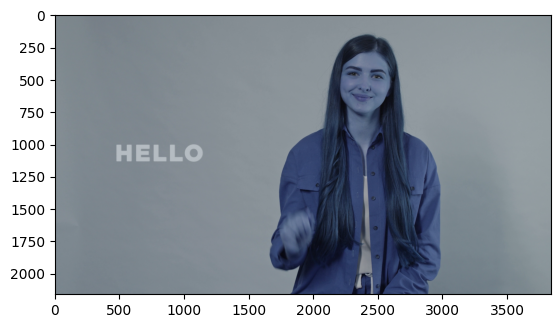

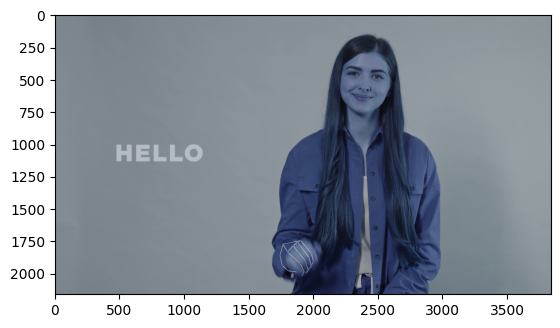

In [5]:
import cv2
import mediapipe as mp
import matplotlib.pyplot as plt

mp_hands = mp.solutions.hands
mp_drawing = mp.solutions.drawing_utils
hands = mp_hands.Hands(static_image_mode=False,
                       max_num_hands=2,
                       min_detection_confidence=0.5,
                       min_tracking_confidence=0.5)

cap = cv2.VideoCapture('sample.mp4')

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    results = hands.process(frame)

    """
    The missing results could be processed by Kalman filters.
    Different users have different gestures (mainly for different durations).
      I think this should be pre-defined.
    While streaming, short video clips might be pushed to imagebind. For
      pre-trained models or fine-tuned models.
    """

    frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

    if results.multi_hand_landmarks:
        for hand_landmarks in results.multi_hand_landmarks:
            mp_drawing.draw_landmarks(
                frame, hand_landmarks, mp_hands.HAND_CONNECTIONS)

    plt.imshow(frame)
    plt.show()

cap.release()
cv2.destroyAllWindows()
